In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [22]:
# read in data
df_all = pd.read_csv('Data/metro-bike-share-trips-2020-q1.csv')
head = df_all.head()

In [23]:
# control total 
row_count = len(df_all.index.to_list())
row_count

76391

In [29]:
# review columns and data types
data_type_list = df_all.dtypes
data_type_list

trip_id                  int64
duration                 int64
start_time              object
end_time                object
start_station            int64
start_lat              float64
start_lon              float64
end_station              int64
end_lat                float64
end_lon                float64
bike_id                  int64
plan_duration            int64
trip_route_category     object
passholder_type         object
bike_type               object
dtype: object

In [41]:
# clean data

# pull in relevant columns
df_time_lat_lon = df_all[["start_time", "start_lat", "start_lon", "end_lat", "end_lon"]]

# stack ending lats and lons below starting lats and lons
df_starts = df_time_lat_lon.iloc[:, [0, 1, 2]]
df_ends = df_time_lat_lon.iloc[:, [0, 3, 4]]

new_columns = ["date", "lat", "lon"]
df_starts.columns = new_columns
df_ends.columns = new_columns

df_stacked = pd.concat([df_starts, df_ends], ignore_index=True)

#convert date column to date data type
df_stacked["date"] = pd.to_datetime(df_stacked["date"])
df_stacked["date"] = df_stacked["date"].dt.date
df_stacked

# QC
# df_stacked

,date,lat,lon
0,2020-01-01,34.048038,-118.253738
1,2020-01-01,NaN,NaN
2,2020-01-01,34.014309,-118.491341
3,2020-01-01,34.014309,-118.491341
4,2020-01-01,34.014309,-118.491341
...,...,...,...
152777,2020-03-31,33.994850,-118.417961
152778,2020-03-31,34.044701,-118.252441
152779,2020-03-31,34.040600,-118.253838
152780,2020-03-31,34.037460,-118.265381


In [15]:
# determine min and maxes of start/end lat and start/end lon
min_lon = df_stacked.lon.min()
max_lon = df_stacked.lon.max()
min_lat = df_stacked.lat.min()
max_lat = df_stacked.lat.max()

BBox = (min_lon, max_lon,
        min_lat, max_lat)

BBox

(-118.49134099999999, -118.231277, 33.943359, 34.186569)

In [31]:
# read in map file
la_map = plt.imread('Data/LA_Map.png')

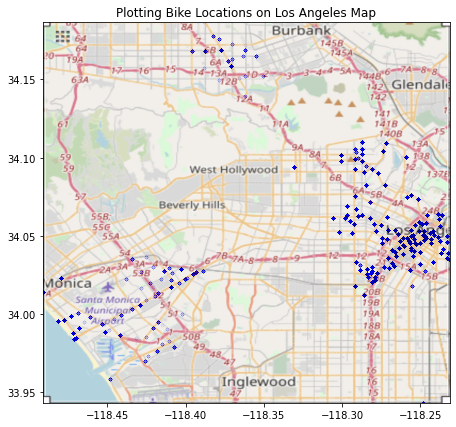

In [53]:
# plot all lats and lons
fig, ax = plt.subplots(figsize=(8, 7))
ax.scatter(df_stacked.lon, df_stacked.lat, zorder=1, alpha=0.002, c='b', s=10)
ax.set_title('Plotting Bike Locations on Los Angeles Map')
ax.set_xlim(BBox[0], BBox[1])
ax.set_ylim(BBox[2], BBox[3])
ax.imshow(la_map, zorder=0, extent=BBox, aspect='equal')

plt.show()

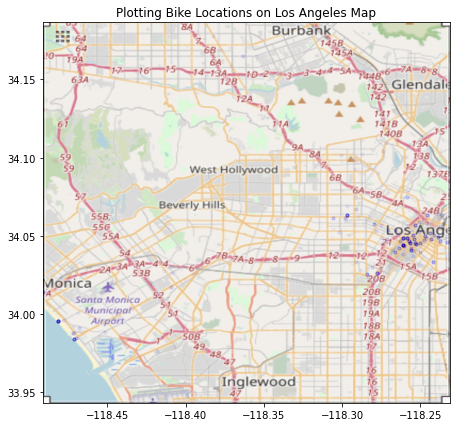

In [60]:
# select only January 12, 2020 (Sunday) for our data set
Sunday = pd.to_datetime("2020-01-12")

df_stacked_Sunday = df_stacked.loc[df_stacked["date"] == Sunday]
df_stacked_Sunday

# plot lats and lons for a weekend day (Sunday)
fig, ax = plt.subplots(figsize=(8, 7))
ax.scatter(df_stacked_Sunday.lon, df_stacked_Sunday.lat, zorder=1, alpha=0.01, c='b', s=10)
ax.set_title('Plotting Bike Locations on Los Angeles Map')
ax.set_xlim(BBox[0], BBox[1])
ax.set_ylim(BBox[2], BBox[3])
ax.imshow(la_map, zorder=0, extent=BBox, aspect='equal')

plt.show()

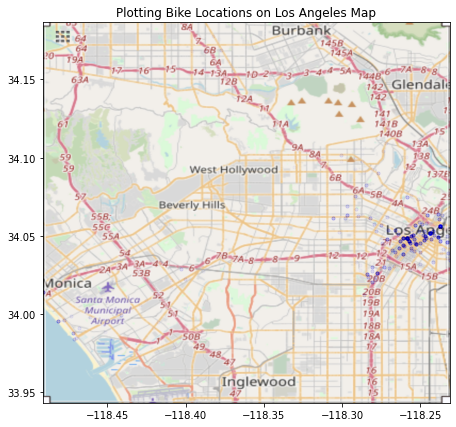

In [61]:
# select only January 13, 2020 (Monday) for our data set
Monday = pd.to_datetime("2020-01-13")

df_stacked_Monday = df_stacked.loc[df_stacked["date"] == Monday]
df_stacked_Monday

# plot lats and lons for a week day (Monday)
fig, ax = plt.subplots(figsize=(8, 7))
ax.scatter(df_stacked_Monday.lon, df_stacked_Monday.lat, zorder=1, alpha=0.01, c='b', s=10)
ax.set_title('Plotting Bike Locations on Los Angeles Map')
ax.set_xlim(BBox[0], BBox[1])
ax.set_ylim(BBox[2], BBox[3])
ax.imshow(la_map, zorder=0, extent=BBox, aspect='equal')

plt.show()